# Video Analysis Tutorial

This project was born out of a need for rapid, easily accesible and effective analysis methods for analysis of in situ TEM videos. Python is a very powerful language for this type of analysis based on the wide accessibility of different packages to perform a range of functions on the image. However, for many cases this makes the barriers for entry much harder and the location of relevant functions difficult to find. Here I have collated a number of methods into a single python object to make it easier to deal with electron microscopy videos, particularly those collected with gatan software. 

Before working through this tutorial, I recommend looking at the micrograph tutorial, as the concepts are the same and explained in more detail there, this is mainly looking to scale image based tutorials to videos, and most of the functions involved do exactly that. 

This method is specifically designed for use of videos taken as dm4 movies, as produced from gatan direct electron detectors (eg. our k2 camera). However, once the video frames and pixelsize are loaded, all the functions should work just as well for other formats.

Again this mainly works out of a single class, this time named 'MicroVideo'. I'll start in a similar way to before, however proceed quicker than in the previous tutorial. 

## Import dependancies

In [1]:
from SimpliPyTEM.MicroVideo_class import *


<Figure size 640x480 with 0 Axes>

## Initialise MicroVideo object and open MicroVideo

In [2]:
video = MicroVideo()
print([x for x in os.listdir('.') if 'dm4' in x])
video.open_dm('gold_growth_video_holder_test_070921.dm4')

['A1_Tribloc-100000X-0003.dm4', 'gold_growth_video_holder_test_070921.dm4']
gold_growth_video_holder_test_070921.dm4 opened as a MicroVideo object


Like the Micrograph object, the MicroVideo object contains lot of useful data and useful methods, as well as the video itself. To access the video frames run: 

In [3]:
print(video.frames)

[[[1.938817   0.97793496 0.9605682  ... 0.9376172  1.9308672  0.        ]
  [1.9948605  1.9553921  0.         ... 0.95895725 0.9587276  0.84037113]
  [0.         2.7764306  0.         ... 0.9605682  0.         0.850008  ]
  ...
  [1.0074724  0.         2.0994952  ... 1.0448154  2.069107   1.8612823 ]
  [0.         2.0282178  4.1148167  ... 0.         1.0342863  0.        ]
  [0.         1.0342863  0.         ... 2.067504   1.0302929  0.91594684]]

 [[0.         1.9558699  0.9605682  ... 0.         0.         0.8094414 ]
  [0.         0.         0.         ... 0.         0.9587276  0.84037113]
  [0.         0.         1.9573045  ... 3.8422728  0.         0.850008  ]
  ...
  [1.0074724  2.0600555  2.0994952  ... 1.0448154  1.0345535  0.        ]
  [3.2245066  1.0141089  0.         ... 0.         1.0342863  0.        ]
  [1.0039347  0.         0.         ... 2.067504   0.         0.        ]]

 [[0.9694085  1.9558699  1.9211364  ... 0.         0.         3.2377656 ]
  [1.9948605  0.      

Again, this is no use, these need to be plotted to see anything useful from them, however we can see some information about the size and length of the video:

In [4]:
print(video.frames.shape)
# or simply:
print(video.shape)

(13, 3702, 3834)
(13, 3702, 3834)


So this is a 13-frame video, with a size of 3834 x 3702 (numpy arrays have x and y opposite from normal image programs), lets have a look at how the first frame looks: 

We can also use other video formats e.g. avi or mp4, or load from an array, here the pixelsize and pixelunit are manually inputed: 
    

In [5]:
print([x for x in os.listdir('.') if x[-3:]=='avi'])

['Output_video.avi']


## Loading videos from Avi/Mp4

Videos can be easily loaded from avi's or Mp4's, however these dont have a pixelsize or pixelunit by default, and also miss the metadata. This is simply achieved as follows:

Note that the files opened here are created at the end of the notebook and are not shipped with the tutorial, so either change the filename (Output_video.___ or do the rest of the tutorial before trying this)

In [6]:
avi_vid = MicroVideo()
avi_vid.open_video('Output_video.avi', pixel_size=0.1, pixel_unit='nm')


Can't receive frame (stream end?). Exiting ...
13 frames loaded as micrograph object
As format is avi, the pixelsize is not loaded automatically, please set this using micrograph.pixel_size = n


In [7]:
mp4_vid = MicroVideo()
mp4_vid.open_video('Output_video.mp4', pixel_size=0.1, pixel_unit='nm')

Can't receive frame (stream end?). Exiting ...
13 frames loaded as micrograph object
As format is avi, the pixelsize is not loaded automatically, please set this using micrograph.pixel_size = n


In [8]:
print(mp4_vid.pixel_size)

0.1


### Setting scale 

As with the micrograph, we can set the scale with a measurement of a scalebar of the video or knowing the size using the set_scale() method.


In [9]:
#Here I measured a scalebar labelled 50nm to be 173 pixels - the pixelsize will be calculated from this.
mp4_vid.set_scale(pixels=173, dist=50, unit='nm')
print(mp4_vid.pixel_size, mp4_vid.pixel_unit)

0.28901734104046245 nm



## Showing video stills

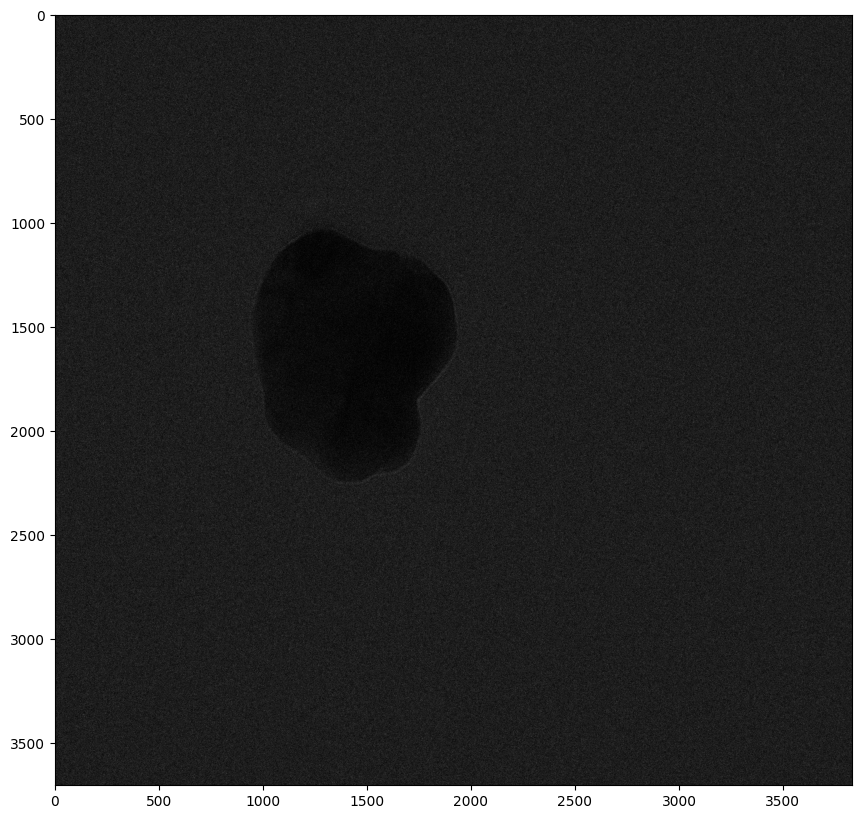

In [10]:
video.imshow()

Well thats not very revealing! 
Clearly each frame is quite low contrast, lets see what the histogram looks like.



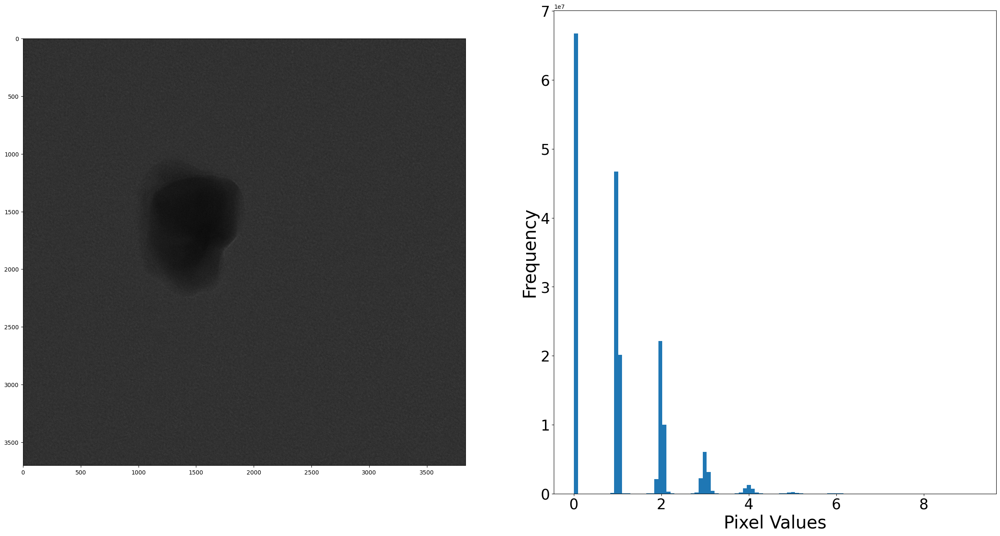

In [11]:
video.plot_histogram(sidebyside=True)

So we dont have much signal, but we an also see that the maximum pix value is 12 (the x axis maximum) despite the fact that there are very few pixels with counts above 5. 

Lets see if we can display it better using the matplotlib library using plt.imshow() whilst adding limits into it.

We can do this by adding the vmax and vmin arguments to video.imshow()

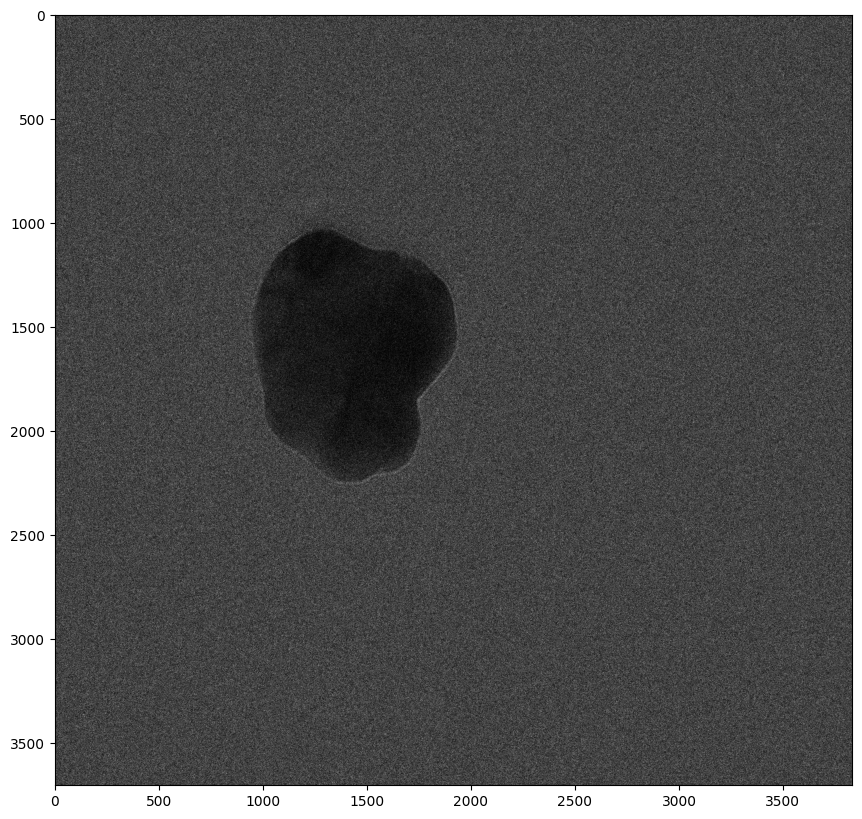

In [12]:
video.imshow(vmax=4, vmin=0)

Well thats still quite noisy, but we can at least see the particles a bit better! This is a low dose video with a relatively fast frame rate (we'll see how fast when discussing the metadata later)!

Lets trying to see what an average (or technically a sum) of this video looks like:

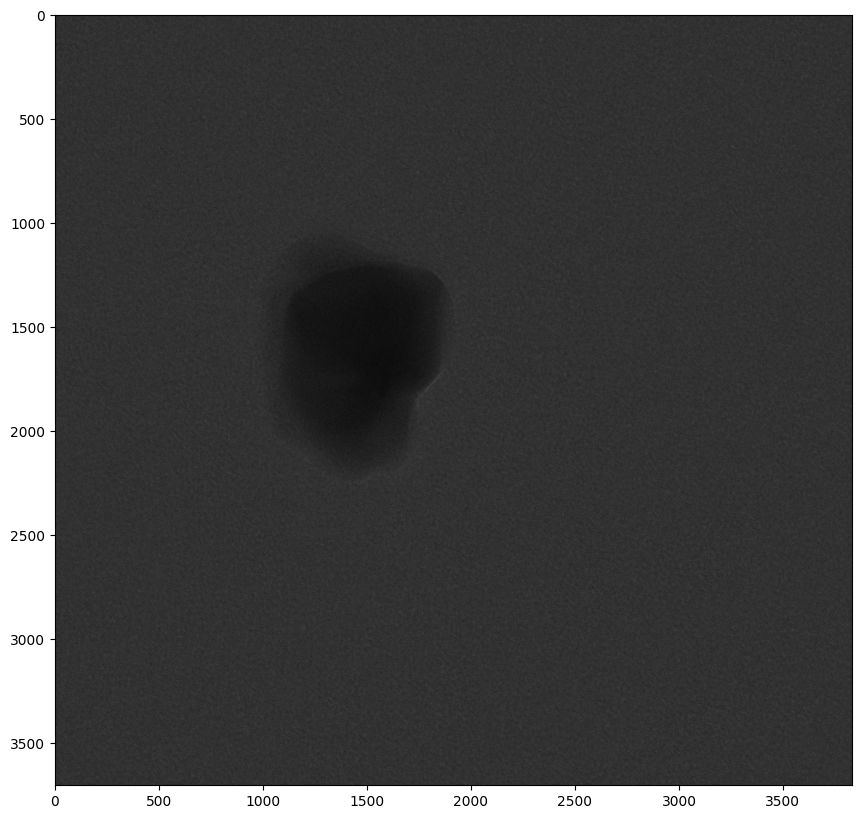

In [13]:
video.imshow(average=True)

Much better! the particles have much clearer outlines, still not plotting very well though, lets try plotting with a vmax set again. Here rather than using a built-in function, I am using numpy sum all the video frame into a single array - this works on the time/Z axis (axis 0). 

Remember though: as we are summing the frames, the vmax needs to increase as well! We can replot the histogram with the average to see what would be suitable.

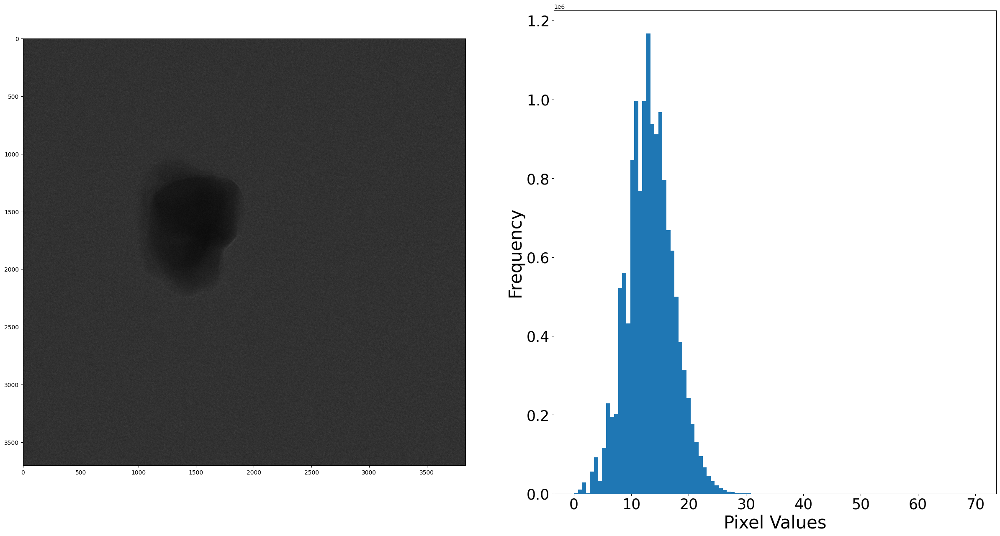

In [14]:
video.plot_histogram(imAverage=True, histAverage=True,sidebyside=True)

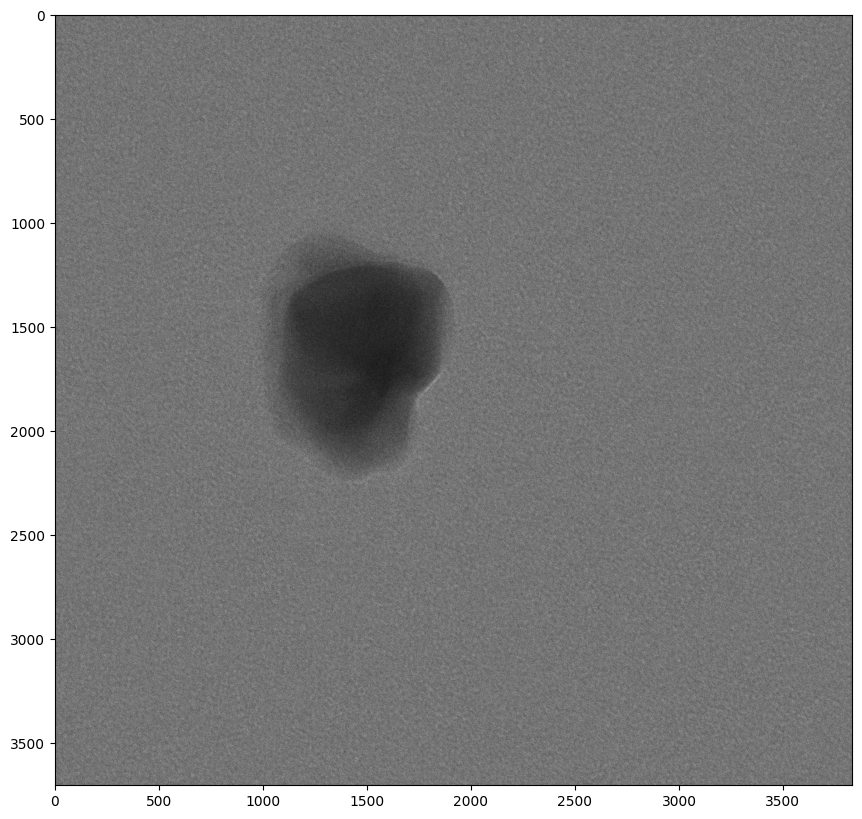

In [15]:
video.imshow(average=True, vmax=30)

Well thats a bit clearer, but I'm sure we can do better! I'll come back to that later on. 


Sometimes, I have taken a video, however I want to treat it like a single image. In these instances, the to_micrograph() function can be used. 

In [16]:
im = video.toMicrograph()

Now we have a micrograph object: 'im', we can see the type of this as follows.

In [17]:
type(im)

SimpliPyTEM.Micrograph_class.Micrograph

Now im can be used as shown in the micrograph tutorial.

## Showing video

we can video in a jupyter notebook using the built in method .show_video(). This method uses MoviePy to show the video in ipython notebooks. 

You are able to loop the video (set `loop=1`), choose the frame rate (`fps=25`) and set the width of the video shown (`width=500`).

Note that this will show the video in the current state, so I recommend preprocessing, here I perform basic methods which will be discussed below.

In [18]:
#preprocess: 
vid = video.bin()
vid = video.gaussian_filter(5)
vid = video.clip_contrast()

Saturation =  0.5
Maxmium value :  115.0
Minimum value :  0.0
115.0 0.0


In [19]:
#Show video
#vid.show_video()

#I'm not running this because I can't upload it to github 
# with the video embedded, I promise it works though! 

## Metadata

So like with the micrographs, metadata from dm files is automatically loaded in and can be easily accessed: 

In [20]:
print(video.pixel_size)
print(video.pixel_unit)

0.08174395561218262
nm


In [21]:
fps, time = video.get_exposure()

Frame rate : 2.5fps
Exposure time per frame: 0.4s 
Imaging time: 5.2s
Number of frames: 13


In [22]:
date, time = video.get_date_time()

In [23]:
print(video.fps)
print(video.AqDate)
print(video.AqTime)

2.5
07/09/2022
17:58:27


If you have other video formats which include metadata and you would like this built in, feel free to request it and I will try to add it to the package

## Video transformations

Here are the useful bits.

### Averaging the video

Often in situ EM videos have very little signal in each individual frames, and so we need to average multiple frames together. There are two built in functions for this: Average_frames and Running_average.

These functions both return a new object with the frames averaged together:
   
    - Average_frames simply splits the video into groups of n frames and sums these. 
    
    - Running_average performs a 'sliding window' averaging preceedure, frames are still split into groups of n frames, however in this case these overlap with only a single frame offset. 
    


In [24]:
Simple_average = video.Average_frames(3)


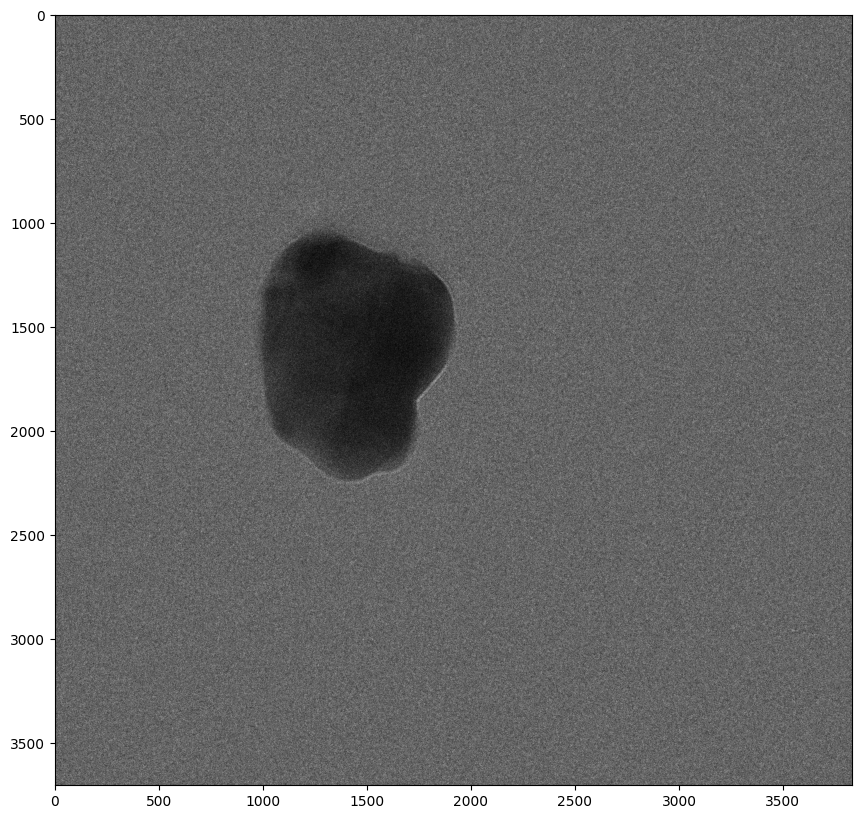

In [25]:
Simple_average.imshow(vmax=8, vmin=0)

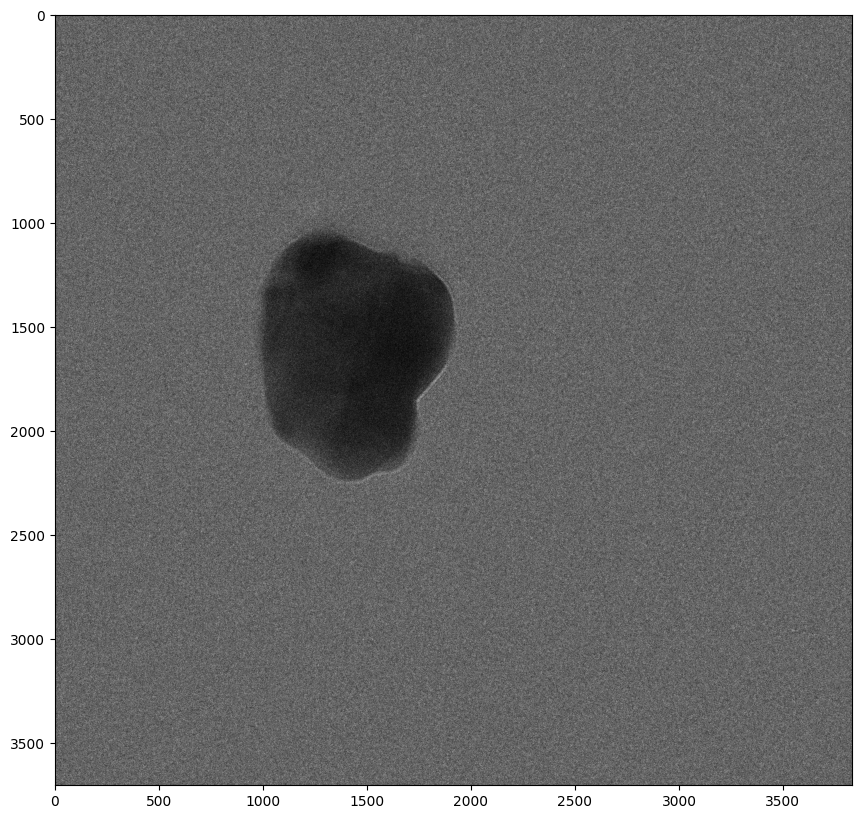

In [26]:
Running_average = video.Running_average(3)
Running_average.imshow(vmax=8, vmin=0, framenumber=0)

These look the same right? That is because they are. The first frame of these both will be the same, the difference is the number of frames (and therefore the time resolution available):


In [27]:
print('The original video has {} frames'.format(len(video)))
print('The simple average has {} frames'.format(len(Simple_average)))
print('The running average has {} frames'.format(len(Running_average)))

The original video has 13 frames
The simple average has 5 frames
The running average has 10 frames


The advantage of running averging is that it retains some of the time resolution that is lost in averaging, however it is the changes between frames are significantly reduced by this averaging.

Here I am going to reset the variables to reduce memory space:

In [28]:
%reset_selective -f Simple_average
%reset_selective -f Running_average


## xy bin video 

Reducing size on the XY axis can be very useful for processing times as it greatly reduces the size of the video and therefore the number of pixels, and the data included. It will also lead to increased contrast.

This is done very simply: 


In [29]:
video_binned = video.bin()

In [30]:
print(video_binned.frames.shape)

(13, 1917, 1851)


From here on out I will use the binned video to speed up the processing times. 

In [31]:
video=video.bin()

### Convert to 8-bit

This scales the video between 0 and 255, more details are given in the micrograph tutorial. 

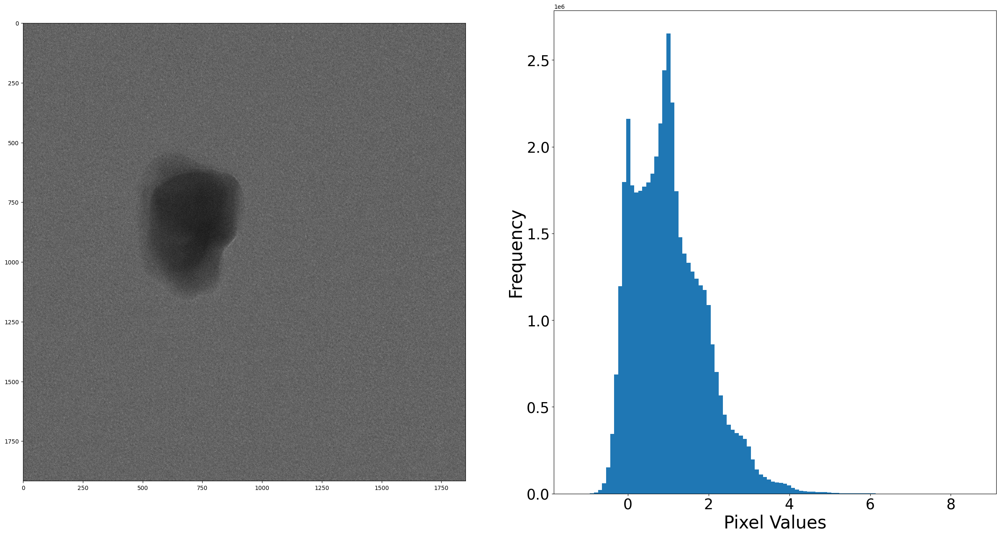

In [32]:
# Original histogram

video.plot_histogram(sidebyside=True)

In [33]:
video8bit = video.convert_to_8bit()

Lets check if its different! 


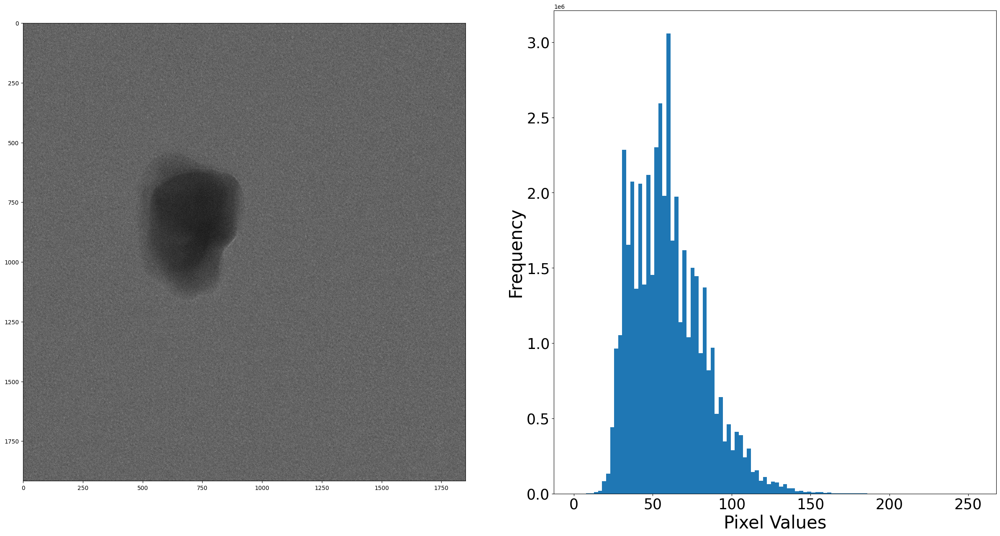

In [34]:
video8bit.plot_histogram(sidebyside=True)

So we have scaled the video between 0 and 255, however we can still see the histogram is skewed to the right, with almost no pixels having a light value, now we can see this better by adding vmax/vmin into the image, however we can also use the methods below to improve this. 


## Contrast enhancement 

The MicroVideo class has the same contrast enhancement methods as the Micrograph class. 

Clip contrast is my favourite method - this simply adjusts the blackpoint and whitepoint of the image, the maximum and minimum pixel values in the image,  and scales the pixel values to these new points. 

The maximum and minimum value can be given using the maxvalue and minvalue options, however this can also be automated using the (default) saturation option. This decides what percentage of pixels are white/black, such that saturation = 0.5 means that 0.5% of pixels in the video are white and 0.5% of pixels are black. One of the minimum/maximum can also be used and the other will work with the saturation method. 



In [35]:
video8bit_clipped = video8bit.clip_contrast(saturation=0.5)

Saturation =  0.5
Maxmium value :  134.0
Minimum value :  22.0
134.0 22.0


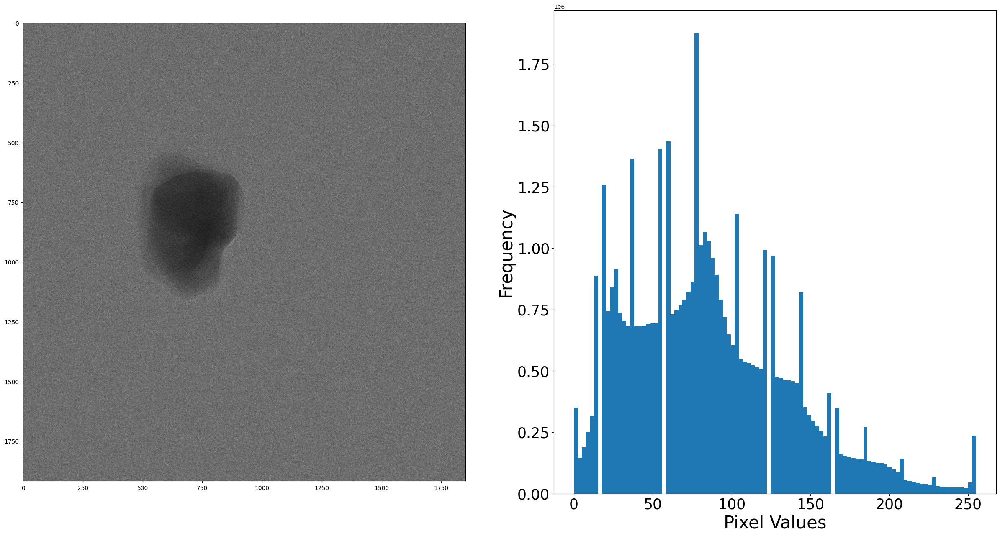

In [36]:
video8bit_clipped.plot_histogram(sidebyside=True)

Minimum value :  22.0
80 22.0


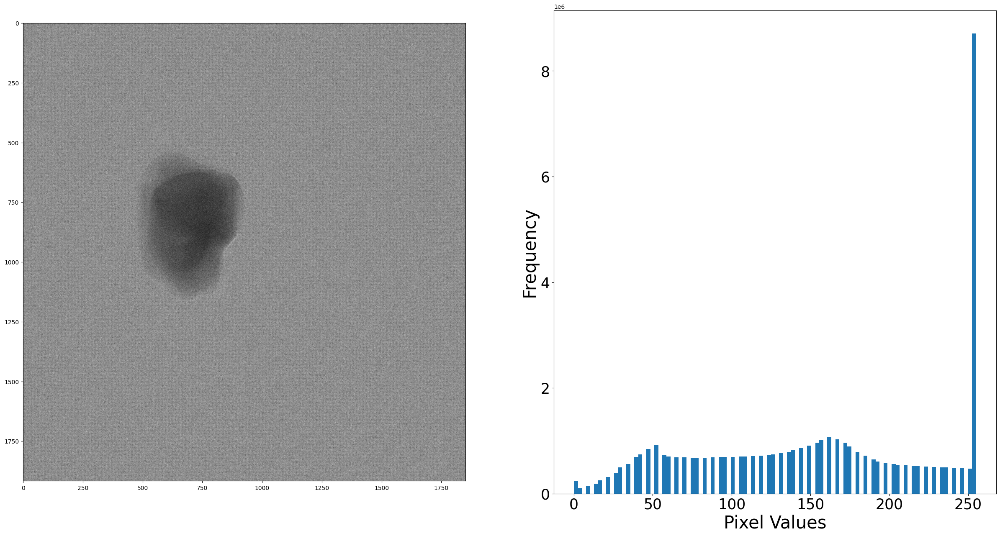

In [37]:
video8bit_clipped = video8bit.clip_contrast(maxvalue = 80, minvalue =0 )
video8bit_clipped.plot_histogram(sidebyside=True)

Other methods to enhance the contrast are included, these are 'enhance_contrast' using OpenCV's built in methods allowing for alpha (contrast), beta (brightness) and gamma (non-linear brightness) control. Histogram equalisation (ensuring a good spread of pixel values, or a flat histogram) is also included. 

These methods are discussed in more detail in the micrograph analysis tutorial, and work in the same way.


## Video filters

A number of video filters are available, as with the micrograph class: 

 - Median filter: performs a median filter with kernal size defined in the call (default is 3)
 
 - Gaussian filter: performs a Gaussian filter with kernal size defined in the call (default is 3)
 
 - Weiner filter: performs a Weiner filter with kernal size defined in the call (default is 5)
 
 - Low pass filter: performs a 2D fourier transform of the image and removes the  
 
 - Non-local means filter: this compares similar regions of the image and denoises by averaging across them. This is performed by openCV, and more info can be found here: https://docs.opencv.org/3.4/d5/d69/tutorial_py_non_local_means.html


The syntax for these are all the same:
    
   > filtered_video_object = video.*****_filter(strength)
    
where \**** is one of the following: 
> median 
>
> gaussian
>
> weiner
>
> low_pass
>
> NLM

The 'Strength' value is more vairable, however all except the low pass filter have default values between 3 and 11, and require odd values (because they require a n\*n kernal with a single middle value. 


For more details on each function look at the micrograph analysis tutorial or  run

   > help(video.****_filter)
   
These are all used to reduce the noise in the image in different ways, and can be effective in difference circumstances, I recommend trying out all of them, in particular the median, gaussian and low pass filters. 

In [38]:
video_gaussian = video8bit.gaussian_filter(3)


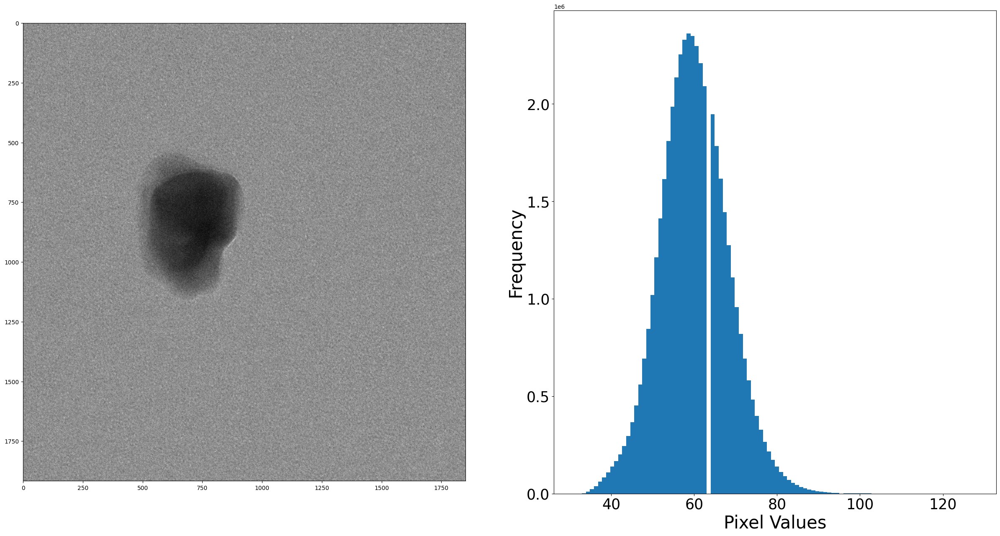

In [39]:
video_gaussian.plot_histogram(sidebyside=True)

Saturation =  0.5
Maxmium value :  139.0
Minimum value :  21.0
139.0 21.0


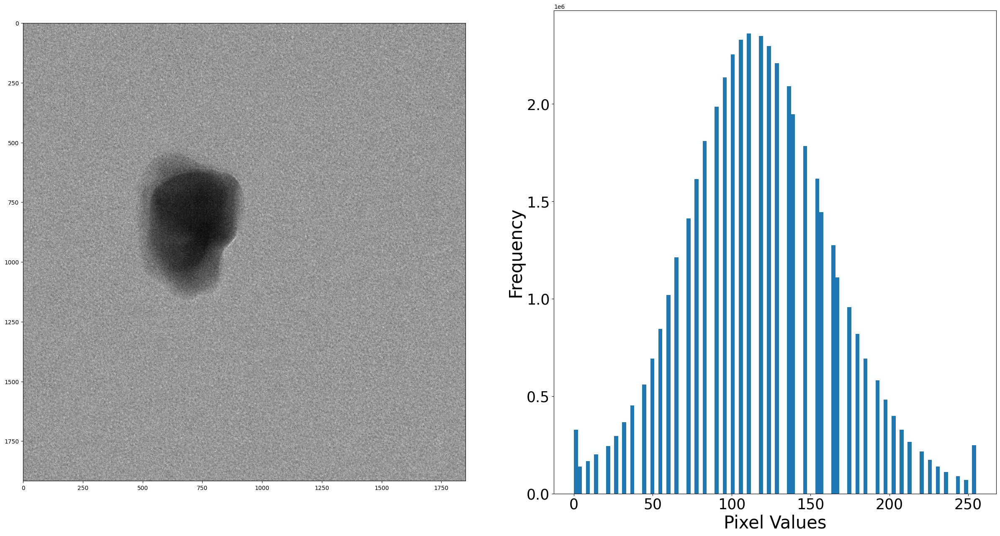

In [40]:
video_gaussian_clipped = video_gaussian.clip_contrast()
video_gaussian_clipped.plot_histogram(sidebyside=True)

I like how this looks, so I will proceed with this video and remove the remaining videos to reduce memory.

In [41]:
video = video_gaussian_clipped

%reset_selective -f video_gaussian
%reset_selective -f video8bit
%reset_selective -f video_binned

## Add scalebar
This is super simple - just run:


In [42]:
videoSB = video.make_scalebar()

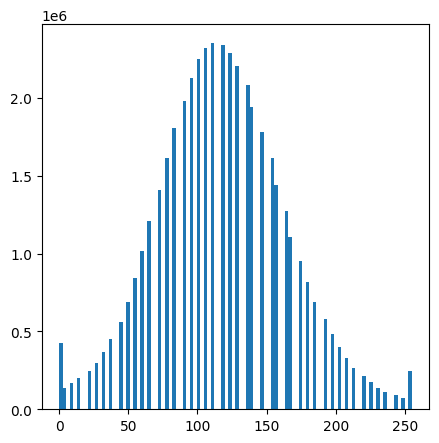

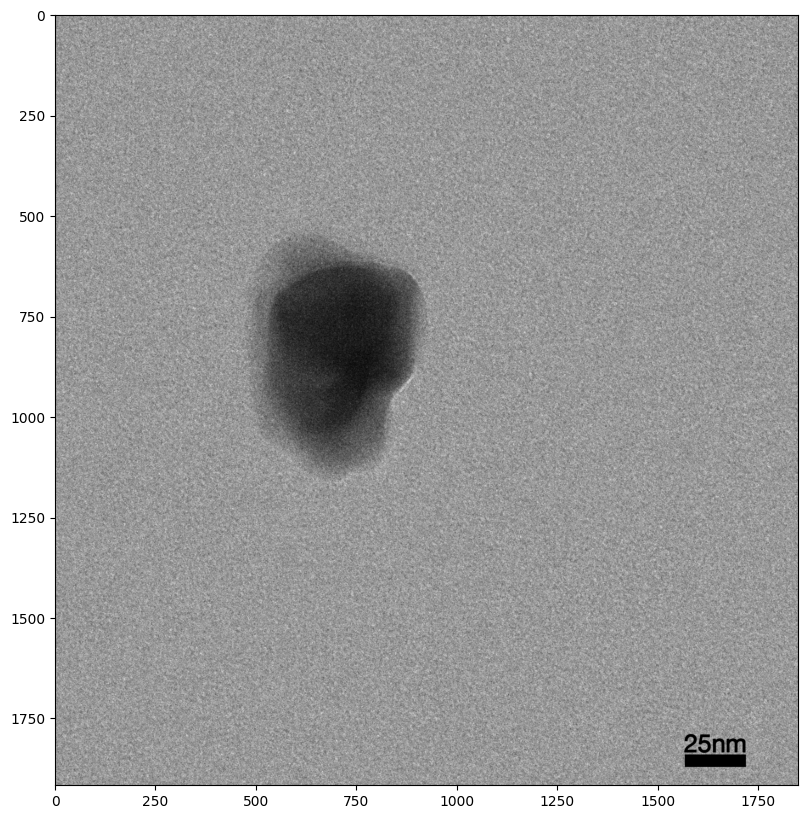

In [43]:
videoSB.plot_histogram()
videoSB.imshow(average=True)

## Saving data 

We have multiple choice when saving the data, we can save a single frame, an average frame,  a sequence of images, a tif 'stack' (all frames in one file) , an .avi video and an mp4 video. These have simple syntax: 


In [44]:
video.write_image('Video_averaged',average=True)
video.write_image('First_frame', average=False, framenumber=0)
video.write_image('Last_frame', average=False,framenumber=-1)


Start name : Video_averaged
if name :  Video_averaged
2648 22
converting to 8bit
Video_averaged.jpg Done!
Start name : First_frame
if name :  First_frame
First_frame.jpg Done!
Start name : Last_frame
if name :  Last_frame
Last_frame.jpg Done!


In [45]:
video.save_tif_sequence(outdir='Frames')

In [46]:
video.save_tif_stack(outdir='.')

In [47]:
video.write_video('Output_video.mp4')
video.write_video('Output_video.avi')

Moviepy - Building video Output_video.mp4.
Moviepy - Writing video Output_video.mp4



Moviepy - Done !
Moviepy - video ready Output_video.mp4
Moviepy - Building video Output_video.avi.
Moviepy - Writing video Output_video.avi



Moviepy - Done !
Moviepy - video ready Output_video.avi


## Advanced functions

While the above functions will be good enough for many examples, there are some more specific functions, I may add more functions here from time to time. 

## Video normalisation 

Often the contrast in videos change significantly over frames, which can be distracting. Contrast can be normalised across the frames using either mean or median normalisation - these ensure the mean or median values of each frames are equal, so far these have appeared to give similar results so try either and if that doesnt sort your needs, try the other



In [48]:
normalised_video = video.Normalise_video(normtype='mean')
normalised_video = video.Normalise_video(normtype='median')

## Motion Correction

This uses motioncor2 to align the frames of a video, correcting for whole frame motion in the video. 

Now this is tricky to set up so please consult with the documentation fully (add link to documentation) before attempting this! 

However, it can be very effective, particularly when combined with averaging of frames. 

The method is basically as follows: 

    - save a tif stack (using the save_tif_stack) function
    - call motioncor2 to motioncorrect the tif-stack and align the frames, saving them a .mrc stack 
    - Open the outputted .mrc stack as a microvideo object, which is then returned by the function. 


Hopefully your features will all be fairly well aligned, reducing drift across the video, I recommend averaging the frames and comparing the motion-corrected version to the original. The effectiveness of this varies massively, particularly depending on how much the sample changes in the video and the drift in the video. 


Use it (once you've downloaded motioncor2 and set the executable path as detailed in the documentation) as follows: 


In [49]:
mcor_vid = video.motioncorrect_vid()

#This line is going to error because the prvious line is not successful, as the output says the path to a motioncor executable 
#needs to be defined on your system, see documentation of the function for details.
mcor_av = mcor_vid.Average_frames(3)


outname =  gold_growth_video_holder_test_070921Motion_corrected.mrc
cwd =  /Users/gabriel/python_imageanalysis/Micrograph_analysis_scripts/docs/Tutorials
Sorry, the motioncor2 exectuable is not defined and so cannot be run. Please give the executable using "export MOTIONCOR2_PATH='PATH/TO/EXECUTABLE'" (or on windows: "setx MY_EXECUTABLE_PATH 'path/to/executable'") for more info, please see documentation  


AttributeError: 'int' object has no attribute 'Average_frames'

In [ ]:
# Now lets compare the difference on a single frame (first we need to average the other frame):

#Average the original frame:
video_average3frames = np.sum(video.frames[:3], axis=0)



mcor_av.imshow_pair(video_average3frames,'MotionCorrected', 'Original' )

## Display FFT

You can produce the 2D fourier transform of the video using the display_fft() method. FTs can be useful to see periodic features, or the Thon rings resulting from CTF, which can also identify defocus and astigmatism.

In my work, this is normally desired as an average or motioncorrected average and so this can be easily produced by using the average=True parameter, this is also the default. 

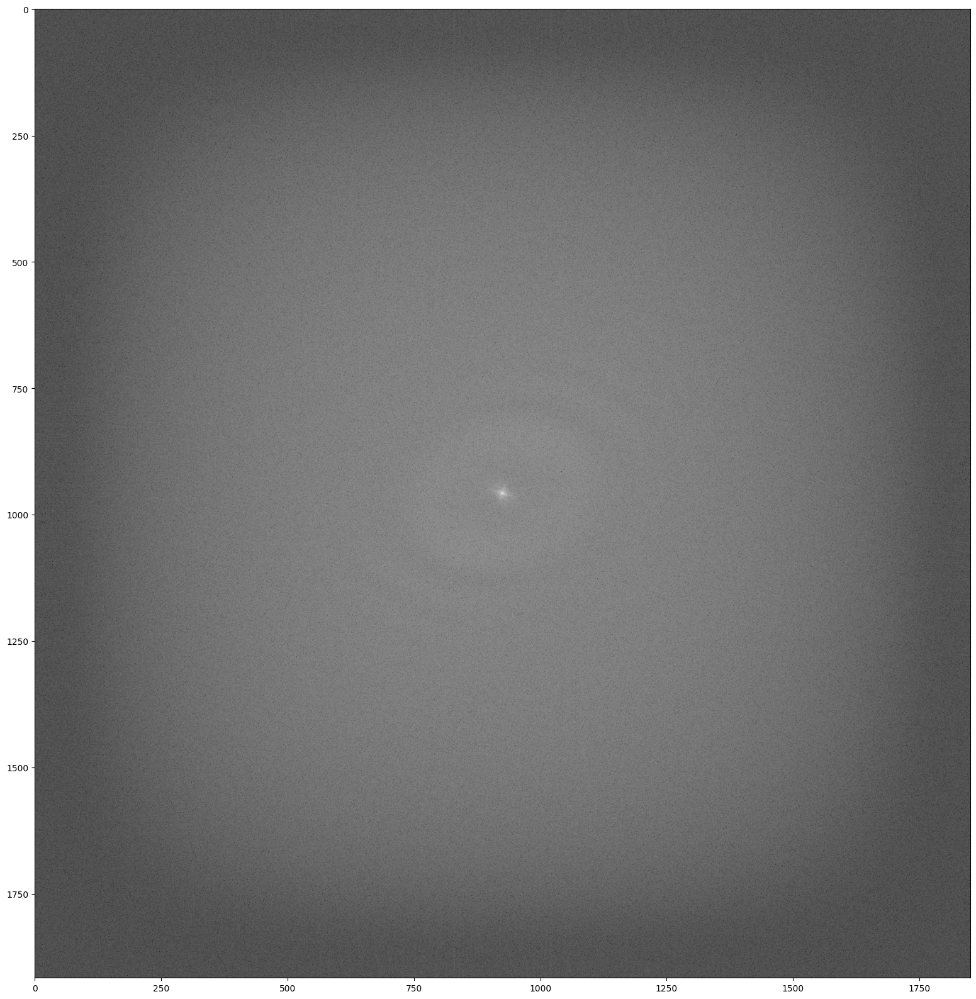

In [50]:
video.display_fft()

This can also be returned as a new micrograph object for further analysis using the `ret` parameter:

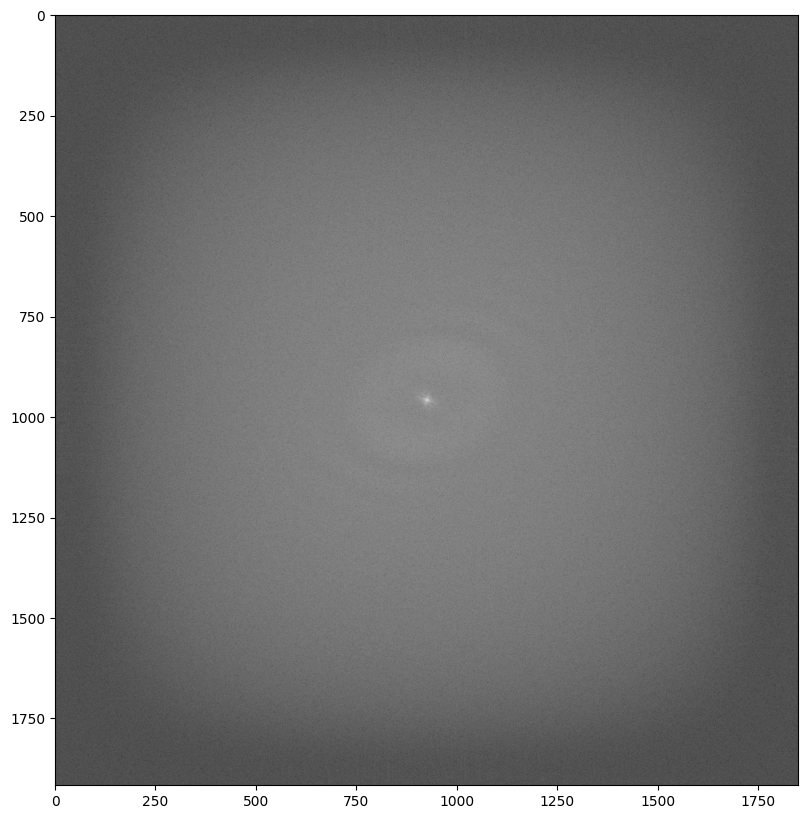

In [51]:
fft = video.display_fft(ret=True)
fft.imshow()

We can also look at the FFT over time by returning the video FFT as a new MicroVideo object, here we just set `average=False`, no other parameters matter after this. 

(13, 1917, 1851)


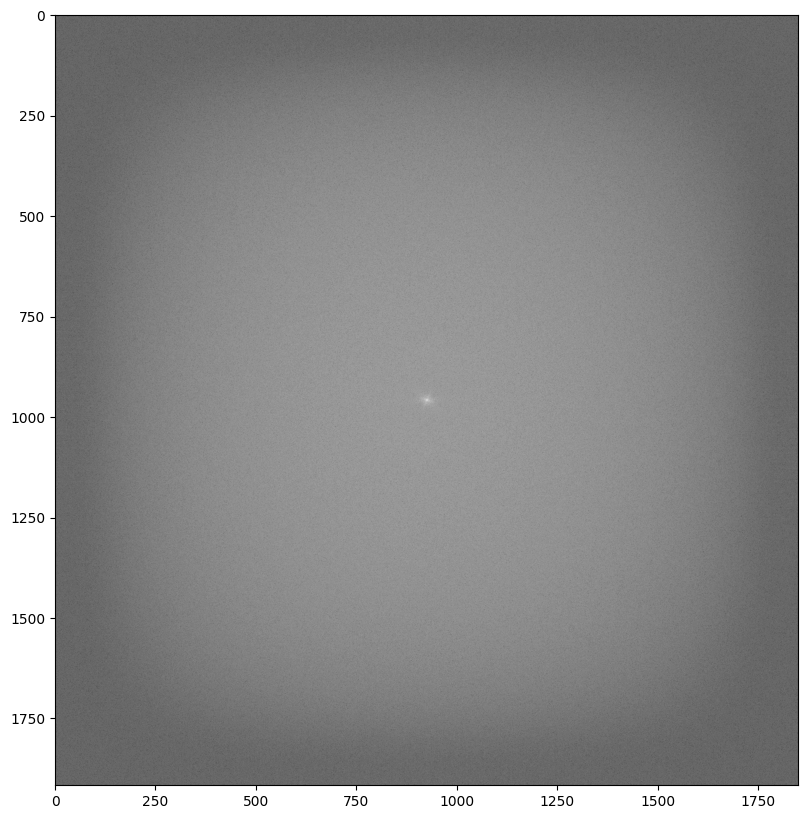

In [52]:
fft_vid = video.display_fft(average=False)
print(fft_vid.shape)
fft_vid.imshow()

## Local normalisation

Some videos have uneven contrast throughout the frames of the video, this can make it difficult to do certain tasks including thresholding particles to locate them in video frames. To fix the uneven contrast the `local_normalisation` function can be used, this works in the same way as for image (although will take a bit longer for videos), so I recommend looking at this section in the micrograph analysis section for this.